# Курсовой проект по курсу "Интерпретируемый ИИ и майнинг данных"
## Часть 1: Работа с табличными данными
## Этап 3-4: Применение SHAP и LIME  

## 📄 Постановка задачи:

### 3. Применение SHAP `(3 балла)`

🔹 **3.1.** Сравнить важность признаков, получаемую с помощью ***SHAP*** с важностью признаков, получаемую с помощью модели на основе ансамбля деревьев решений. Прокомментировать результат (Есть ли разница? Можете ли вы это объяснить?).  

🔹 **3.2.** Среди $3$ методов, выбрать один, который обеспечивает наилучшее качества решения. Проанализировать ***SHAP-values*** для всего набора данных в целом. Меняется ли существенно важность признаков внутри класса и между классами? Какие признаки наиболее важны?  

🔹 **3.3.** Для того же метода, что и в вопросе выше, выбрать $2$ примера из разных классов, где модель дает правильный ответ, и $2$ примера из разных классов, где модель ошибается. Проанализировать эти примеры для всех $3$ моделей с помощью ***SHAP***. Похожи ли объяснения? (Внимание: $4$ примера $\cdot$ $3$ модели $= 12$ картинок).
Примеры брать из тестового набора данных.

### 4. Применение LIME  `(1 балл)`
🔹 **4.1.** Применить ***LIME*** к тем же моделям и тем же примерам, что и в предыдущем задании ( $4$ картинки $\cdot$ $3$ модели $= 12$ примеров). Получили ли вы похожее объяснения, что и в предыдущем примере? Если нет, можете ли вы это объяснить.

### 👍🏻📚 SHAP и LIME- полезные материалы:
* [Лекция про SHAP в Лекторий ФПМИ](https://www.youtube.com/watch?v=thArnVotT7U)
* [Ноутбук по SHAP и LIME c лекции MADE](https://colab.research.google.com/drive/13PkMLvLyHdSMYug_DWVMepUgA55AfhUd?usp=sharing#scrollTo=wsdGg3Wk2sy-)
* [Лекция №4 по SHAP и LIME в MADE](https://www.youtube.com/watch?v=fSWaC1TMlzw&t=12267s)
* [Лекция №5 по SHAP и LIME в MADE](https://www.youtube.com/watch?v=MZGODg4QaRI&t=1822s)
* [SHAP в KARPOV.COURSES](https://vk.com/@karpovcourses-interpretaciya-modelei-mashinnogo-obucheniya-v-python-shap)
* [Статья по SHAP на machinelearningmastery.ru](https://www.machinelearningmastery.ru/explain-any-models-with-the-shap-values-use-the-kernelexplainer-79de9464897a/)
* [Хабр - Как интерпретировать предсказания моделей в SHAP](https://habr.com/ru/post/428213/)
* [Random Forest Feature Importance Computed in 3 Ways with Python](https://mljar.com/blog/feature-importance-in-random-forest/)


## ✅ Решение:

### Импорт необходимых модулей

In [1]:
# pip install dill

In [2]:
# pip install -U lime

In [3]:
# pip install shap

In [4]:
# pip install scikit-learn==0.23.2

In [5]:
import dill

import numpy as np
np.random.seed(123)
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn import metrics
from sklearn.preprocessing import LabelEncoder

import shap
# shap.initjs() # для интерактивных графиков
import lime
import lime.lime_tabular



import warnings
warnings.filterwarnings('ignore')

# %matplotlib inline

### Загрузка пайплайнов препроцессинга

In [6]:
with open('prep_with_cat.dill', 'rb') as prep_cat_pipeline:
    prep_cat = dill.load(prep_cat_pipeline)

In [7]:
with open('prep_without_cat.dill', 'rb') as prep_without_cat_pipeline:
    prep_without_cat = dill.load(prep_without_cat_pipeline)

### Загрузка данных

In [8]:
TRAIN_DATA_PATH = 'data/X_train.csv'
TRAIN_TARGET_PATH = 'data/y_train.csv'

TEST_DATA_PATH = 'data/X_test.csv'
TEST_TARGET_PATH = 'data/y_test.csv'

FULL_DATA_PATH = 'data/X_full.csv'
FULL_TARGET_PATH = 'data/y_full.csv'

In [9]:
train_base = pd.read_csv(TRAIN_DATA_PATH)
train = train_base.copy()
train_target_base = pd.read_csv(TRAIN_TARGET_PATH)
train_target = train_target_base.copy()
display(train.shape, train_target.shape)

(641, 11)

(641, 1)

In [10]:
test_base = pd.read_csv(TEST_DATA_PATH)
test = test_base.copy()
test_target_base = pd.read_csv(TEST_TARGET_PATH)
test_target = test_target_base.copy()
display(test.shape, test_target.shape)

(276, 11)

(276, 1)

In [11]:
full_base = pd.read_csv(FULL_DATA_PATH)
full = full_base.copy()
full_target_base = pd.read_csv(FULL_TARGET_PATH)
full_target = full_target_base.copy()
display(full.shape, full_target.shape)

(917, 11)

(917, 1)

In [12]:
train.head()

,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope
0,54,F,NAP,108,267,0,LVH,167,N,0.0,Up
1,55,M,ASY,120,226,0,LVH,127,Y,1.7,Down
2,62,F,ASY,160,164,0,LVH,145,N,6.2,Down
3,47,F,NAP,135,248,1,Normal,170,N,0.0,Flat
4,50,M,NAP,140,233,0,Normal,163,N,0.6,Flat


### 🔹 **3.1.1** Важность признаков на основе ансамбля деревьев решений.
(На основе ноутбука *Get_RF_feature_importances_from_pipeline.ipynb*)

#### Функция для визуализации важностей признаков

In [13]:
def show_feature_importances(feature_names, feature_importances, get_top=None):
    feature_importances = pd.DataFrame({'feature': feature_names, 'importance': feature_importances})
    feature_importances = feature_importances.sort_values('importance', ascending=False)
       
    plt.figure(figsize = (20, len(feature_importances) * 0.355))
    
    sns.barplot(feature_importances['importance'], feature_importances['feature'])
    
    plt.xlabel('Importance')
    plt.title('Importance of features')
    plt.show()
    
    if get_top is not None:
        return feature_importances['feature'][:get_top].tolist()

#### Загрузка обученной модели RandomForestClassifier

In [14]:
with open('models/model_RandomForestClassifier.dill', 'rb') as rf:
    rf_model = dill.load(rf)

Достаем из модели названия числовых признаков:

In [15]:
num_features = rf_model[0].named_steps['preprocessor'].transformers_[0][2]
num_features

['Age', 'RestingBP', 'Cholesterol', 'FastingBS', 'MaxHR', 'Oldpeak']

Достаем из модели названия категориальных признаков:

In [16]:
cat_features = rf_model[0].named_steps['preprocessor'].transformers_[1][2]
cat_features

['Sex', 'ChestPainType', 'RestingECG', 'ExerciseAngina', 'ST_Slope']

Категориальные признаки в пайплайне преобразуются с помощью OneHotEncoding.  
Достаем названия преобразованных категориальных признаков:

In [17]:
cat_features_ohe = rf_model[0].named_steps['preprocessor'].transformers_[1][1].named_steps['ohe'].get_feature_names(cat_features)
cat_features_ohe

array(['Sex_F', 'Sex_M', 'ChestPainType_ASY', 'ChestPainType_ATA',
       'ChestPainType_NAP', 'ChestPainType_TA', 'RestingECG_LVH',
       'RestingECG_Normal', 'RestingECG_ST', 'ExerciseAngina_N',
       'ExerciseAngina_Y', 'ST_Slope_Down', 'ST_Slope_Flat',
       'ST_Slope_Up'], dtype=object)

Объединяем названия признаков в один список.  
В нашем пайплайне сначала преобразовываются числовые признаки, затем категориальные.  
И в преобразованном датасете признаки будут в том же порядке: сначала числовые, затем категориальные.

In [18]:
features_names = num_features + list(cat_features_ohe)
print(f'{len(features_names)} features:\n{features_names}')

20 features:
['Age', 'RestingBP', 'Cholesterol', 'FastingBS', 'MaxHR', 'Oldpeak', 'Sex_F', 'Sex_M', 'ChestPainType_ASY', 'ChestPainType_ATA', 'ChestPainType_NAP', 'ChestPainType_TA', 'RestingECG_LVH', 'RestingECG_Normal', 'RestingECG_ST', 'ExerciseAngina_N', 'ExerciseAngina_Y', 'ST_Slope_Down', 'ST_Slope_Flat', 'ST_Slope_Up']


In [19]:
features_names =\
[
    'Возраст',
    'Арт. давл. покой',
    'Холестерин',
    'Ур. сахара в крови',
    'Макс. част. серд. сокр.',
    'Oldpeak', # сложный медицинский признак
    'Ж. пол',
    'М. пол',
    'Боли в груди - бессимпт.',
    'Боли в груди - атип. ангина',
    'Боли в груди - не ангина',
    'Боли в груди - тип. ангина',
    'ЭКГ - м.б. гипертония',
    'ЭКГ - норм',
    'ЭКГ - не норм',
    'Стенокардия - нет',
    'Стенокардия - да',
    'ST - пониж.',
    'ST - норм',
    'ST - повыш',
]

Изобразим важности признаков на графике:

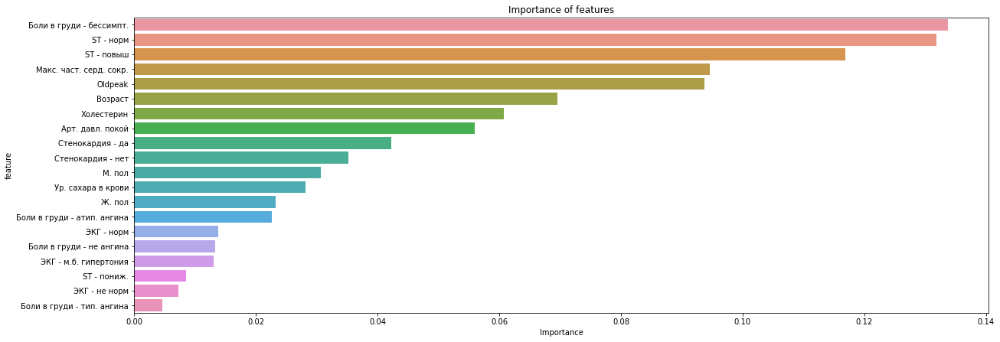

In [20]:
important_features_top = show_feature_importances(
    features_names,
    rf_model[1].feature_importances_,
    get_top=20,
)

Выведем признаки в отсортированном по важности порядке:

In [21]:
feature_importances = pd.DataFrame(data={'feature': features_names, 'importance': rf_model[1].feature_importances_})
feature_importances.sort_values(by=['importance'], ascending=False)

,feature,importance
8,Боли в груди - бессимпт.,0.133717
18,ST - норм,0.131842
19,ST - повыш,0.116850
4,Макс. част. серд. сокр.,0.094642
5,Oldpeak,0.093689
0,Возраст,0.069535
2,Холестерин,0.060810
1,Арт. давл. покой,0.056026
16,Стенокардия - да,0.042212
15,Стенокардия - нет,0.035229


### 🔹 **3.1.2** Важность признаков на основе ***SHAP***.

Создаем объясняющий объект ***explainer***, передав ему уже созданную и обученную ранее модель ***rf_model***:

In [22]:
explainer = shap.TreeExplainer(rf_model.named_steps['classifier'])

Считаем значения Шепли либо для наблюдений из ***train***, поскольку важность признаков в ***RandomForestClassifier*** вычислялась именно на основе ***train***.

In [23]:
train_prep = prep_cat.transform(train) # предобработка данных, как и для RandomForestClassifier
shap_values = explainer.shap_values(train_prep)

Посмотрим на важность признаков с точки зрения их средних  ***shap_values***:  

*(Отмечу, что **plot_type="dot"** тут не доступен, подробнее https://github.com/slundberg/shap/issues/837)*

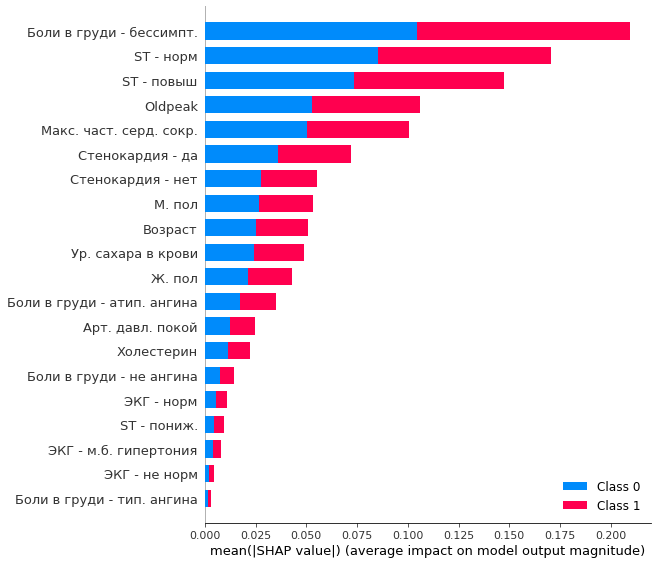

In [24]:
# shap.initjs() # для интеравктивности графиков SHAP
shap.summary_plot(shap_values, train_prep, features_names, plot_type="bar")

✅ **Вывод 3.1:** Итак, мы получили график важности признаков. Заметим, что порядок признаков довольно похож на тот, что был получен при анализе важности признаков ансамбля деревьев, но все-таки они несколько отличаются.  
Разница объясняется тем, что использовались разные алгоритмы вычисления важности признаков. В ***RandomForest*** используется среднее снижение ***impurity***, в то время как в ***SHAP*** используется идея из теории игр.

### 🔹 **3.2**
Среди $3$ методов, выбрать один, который обеспечивает наилучшее качества решения. Проанализировать ***SHAP-values*** для всего набора данных в целом. Меняется ли существенно важность признаков внутри класса и между классами? Какие признаки наиболее важны?  

#### 3.2.1 Выбор модели, которая обеспечивает наилучшее качетсво решения:

Загрузка модели ***LogisticRegressionClassifier***:

In [25]:
with open('models/model_LogisticRegressionClassifier.dill', 'rb') as lr:
    lr_model = dill.load(lr)

Загрузка модели ***RandomForestClassifier***:

In [26]:
with open('models/model_RandomForestClassifier.dill', 'rb') as rf:
    rf_model = dill.load(rf)

Загрузка модели ***MLPClassifier***:

In [27]:
with open('models/model_MLPClassifier.dill', 'rb') as nn:
    nn_model = dill.load(nn)

Сравнение моделей:

In [28]:
classifiers = [("Logistic regression", lr_model), ("Random forest", rf_model), ("Neural networks", nn_model)]

In [29]:
print("Model accuracies:")
for name, clf in classifiers:
    clf.predict(test)
    print("{1:20s} {0:.2f}".format(metrics.accuracy_score(test_target, clf.predict(test)), name))

Model accuracies:
Logistic regression  0.87
Random forest        0.89
Neural networks      0.87


In [30]:
print("F-1 score:")
for name, clf in classifiers:
    clf.predict(test)
    print("{1:20s} {0:.2f}".format(metrics.f1_score(test_target, clf.predict(test)), name))

F-1 score:
Logistic regression  0.88
Random forest        0.90
Neural networks      0.88


Видим, что в данном случае наилучшей моделью является ***Random forest***.

#### 3.2.2 Анализ SHAP-values для всего набора данных в целом. 

In [31]:
explainer = shap.TreeExplainer(rf_model.named_steps['classifier'])
full_prep = prep_cat.transform(full)
shap_values = explainer.shap_values(full_prep)

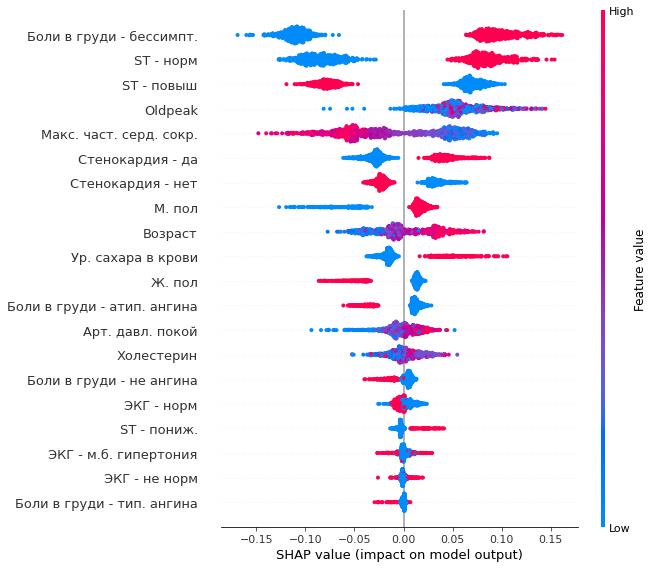

In [32]:
shap.summary_plot(shap_values[1], full_prep, features_names, plot_type="dot")

**Вспомним расшифровку признаков:**
1. Age: age of the patient [years] - **Возраст**
2. Sex: sex of the patient [M: Male, F: Female] - **Пол**
3. ChestPainType: chest pain type [TA: Typical Angina, ATA: Atypical Angina, NAP: Non-Anginal Pain, ASY: Asymptomatic] - **Тип боли в груди**
4. RestingBP: resting blood pressure [mm Hg] - **Артериальное давление в покое**
5. Cholesterol: serum cholesterol [mm/dl] - **Холестерин** 
6. FastingBS: fasting blood sugar [1: if FastingBS > 120 mg/dl, 0: otherwise] - **Уровень сахара в крови натощак**
7. RestingECG: resting electrocardiogram results [Normal: Normal, ST: having ST-T wave abnormality (T wave inversions and/or ST elevation or depression of > 0.05 mV), LVH: showing probable or definite left ventricular hypertrophy by Estes' criteria] - **ЭКГ в покое**
8. MaxHR: maximum heart rate achieved [Numeric value between 60 and 202] - **Максимальная частота сердечных сокращений**
9. ExerciseAngina: exercise-induced angina [Y: Yes, N: No] - **Стенокардия, вызванная физической нагрузкой**
10. Oldpeak: oldpeak = ST [Numeric value measured in depression] - **ST в покое**
11. ST_Slope: the slope of the peak exercise ST segment [Up: upsloping, Flat: flat, Down: downsloping] - **ST при пиковой нагрузке**
12. HeartDisease: output class [1: heart disease, 0: Normal] - **Сердечный приступ**

***Меняется ли существенно важность признаков внутри класса и между классами?***  

Внутри классов важность признаков меняется, поскольку какие-то признаки более важны, а какие-то менее.  
Так, мы видим, что ***ChestPainType_ASY*** т.е. бессимптомная боль в груди намного более важный признак для прогноза сердечного приступа, чем ***ChestPainType_TA***, то есть боль в груди вызванная типичной ангиной.

Между классами важность признаков также меняется.  
Так, мы видим, что высокий ***FastingBS*** т.е. уровень сахара в крови натощак свидетельствует о риске сердечного приступа, в то же время низкий показатель этого признака не так сильно важен для диагноза, что логично, поскольку отсутсвие высокого сахара вовсе не говорит, чо все в порядке.  

***Какие признаки наиболее важны?***  
Наиболее важными признаки являются:
* Бессимптомная боль в груди (***ChestPainType_ASY***)
* ***ST_Slope_Flat***
* ***Oldpeak***
* Максимальная частота сердечных сокращений (***MaxHR***)
* Вызвана ли Стенокардия физической нагрузкой (***ExerciseAngina***)
* Пол (***Sex_M***)
* Возраст (***Age***)

### 🔹 **3.3**
Для того же метода, что и в вопросе выше, выбрать $2$ примера из разных классов, где модель дает правильный ответ, и $2$ примера из разных классов, где модель ошибается. Проанализировать эти примеры для всех $3$ моделей с помощью ***SHAP***. Похожи ли объяснения? (Внимание: $4$ примера $\cdot$ $3$ модели $= 12$ картинок). Примеры брать из тестового набора данных.

#### 3.3.1 Выбор $4$ примеров.
Выберем $2$ примера из разных классов, где модель дает правильный ответ и уверена в них более всего и $2$ примера из разных классов, где модель ошибается, но также уверена в своих ответах больше всего.

In [33]:
predict_fn = lambda x: rf_model.named_steps['classifier'].predict_proba(prep_cat.transform(x)).astype(float)

In [34]:
class0 = np.where(test_target==0, predict_fn(test)[:,0].reshape(-1, 1), np.inf)
false_0 = test[test_target.HeartDisease==0].loc[[np.argmin(class0)]]
false_0_id = np.argmin(class0) # 237
class0 = np.where(test_target==0, predict_fn(test)[:,0].reshape(-1, 1), -np.inf)
true_0 = test[test_target.HeartDisease==0].loc[[np.argmax(class0)]]
true_0_id = np.argmax(class0) # 91

class1 = np.where(test_target==1, predict_fn(test)[:,1].reshape(-1, 1), np.inf)
false_1 = test[test_target.HeartDisease==1].loc[[np.argmin(class1)]]
false_1_id= np.argmin(class1) # 157
class1 = np.where(test_target==1, predict_fn(test)[:,1].reshape(-1, 1), -np.inf)
true_1 = test[test_target.HeartDisease==1].loc[[np.argmax(class1)]]
true_1_id = np.argmax(class1) # 213

In [35]:
print(false_0_id)                    # id
print(predict_fn(test)[false_0_id])  # предсказание
print(test_target.loc[[false_0_id]]) # истина

237
[0.1682058 0.8317942]
     HeartDisease
237             0


In [36]:
print(true_0_id)                    # id
print(predict_fn(test)[true_0_id])  # предсказание
print(test_target.loc[[true_0_id]]) # истина

91
[0.97607653 0.02392347]
    HeartDisease
91             0


In [37]:
print(false_1_id)                    # id
print(predict_fn(test)[false_1_id])  # предсказание
print(test_target.loc[[false_1_id]]) # истина

157
[0.86243263 0.13756737]
     HeartDisease
157             1


In [38]:
print(true_1_id)                    # id
print(predict_fn(test)[true_1_id])  # предсказание
print(test_target.loc[[true_1_id]]) # истина

213
[0.00548286 0.99451714]
     HeartDisease
213             1


In [39]:
examples_list = [false_0_id, true_0_id, false_1_id, true_1_id]
examples_list

[237, 91, 157, 213]

#### 3.3.2 Анализ выбранных примеров для модели ***LogisticRegressionClassifier***

Обычный ***shap.Explainer*** не работал -- (*shap Exception: The passed model is not callable and cannot be analyzed directly with the given masker! Model: LogisticRegression*)  

Поэтому используется ***shap.LinearExplainer***.

In [40]:
train_prep = prep_cat.transform(train)
test_prep = prep_cat.transform(test)

In [41]:
model = lr_model.named_steps['classifier']
explainer = shap.LinearExplainer(model, train_prep)
shap_values = explainer.shap_values(test_prep[examples_list])

Правильный ответ на примере №237: 0
Предсказанный ответ на примере №237: 1
Уверенность в ответе на примере №237: 0.580


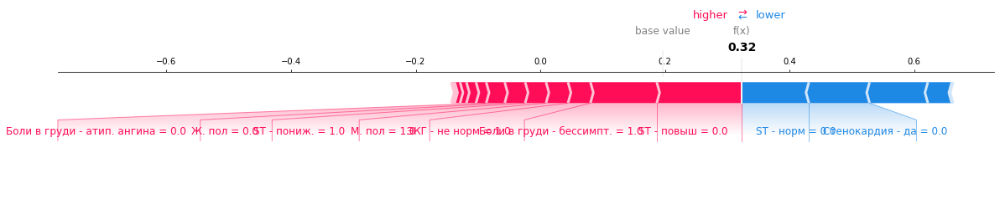

In [42]:
pid = 0
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

# shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[pid], test_prep[examples_list[pid]],
                feature_names=features_names, matplotlib=True)

Ширина столбцов -- соответсвует важности признака для данного примера.  
Справа синим - те признаки, что понижают вероятность сердечного приступа.  
Слева красным - те признаки, что повышают вероятность сердечного приступа.  

Тут мы ошиблись из-за бессимптомной боли в груди и плохом ЭКГ и не повышенном ST.

Правильный ответ на примере №91: 0
Предсказанный ответ на примере №91: 0
Уверенность в ответе на примере №91: 0.675


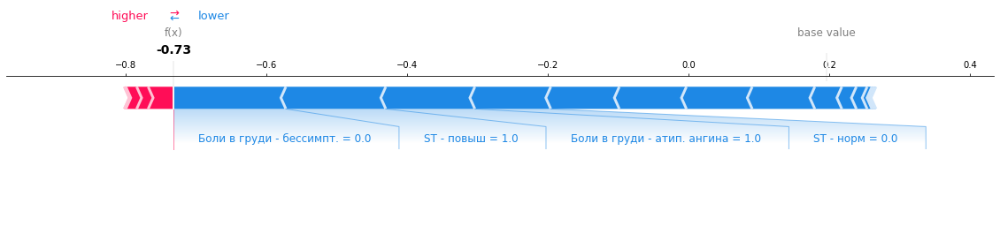

In [43]:
pid = 1
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

# shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[pid], test_prep[examples_list[pid]],
                feature_names=features_names, matplotlib=True)

Сделали правильное предсказание о том, что нет серд. приступа за счет отсутсвия бессимптомной боли в грури и ST повыш.

Правильный ответ на примере №157: 1
Предсказанный ответ на примере №157: 0
Уверенность в ответе на примере №157: 0.557


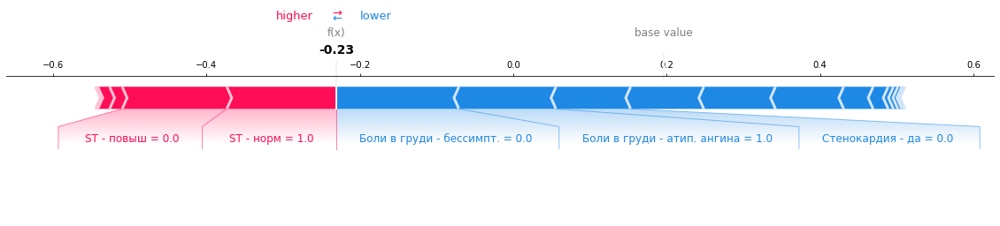

In [44]:
pid = 2
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

# shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[pid], test_prep[examples_list[pid]],
                feature_names=features_names, matplotlib=True)

Неправильно предсказали отсутсвие серд. приступа за счет отсутствия бессимпт. боли в груди.

Правильный ответ на примере №213: 1
Предсказанный ответ на примере №213: 1
Уверенность в ответе на примере №213: 0.668


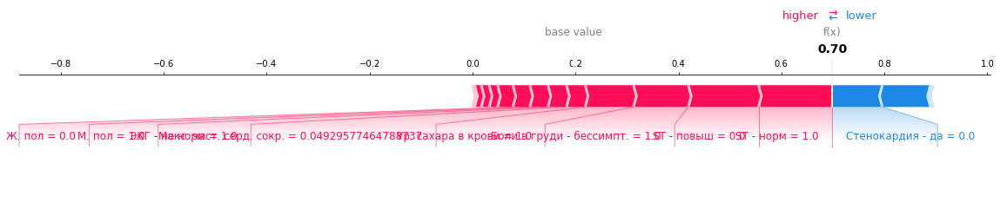

In [45]:
pid = 3
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

# shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[pid], test_prep[examples_list[pid]], 
                feature_names=features_names, matplotlib=True)

Правильно пресказали серд. приступ за счет бессимпт. боли в груди и ST - норм.

#### 3.3.3 Анализ выбранных примеров для модели ***RandomForestClassifier***

In [46]:
model = rf_model.named_steps['classifier']
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(test_prep[examples_list])

Правильный ответ на примере №237: 0
Предсказанный ответ на примере №237: 1
Уверенность в ответе на примере №237: 0.832


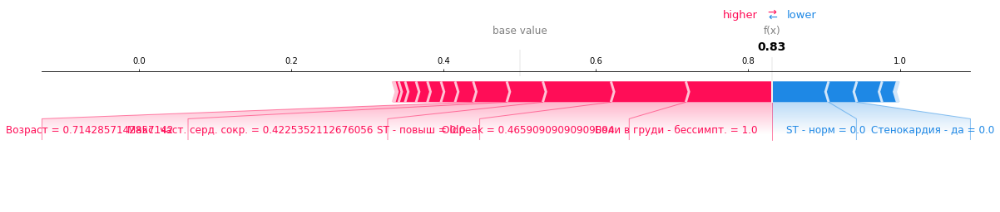

In [47]:
pid = 0
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

# shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1][pid], test_prep[examples_list[pid]],
                feature_names=features_names, matplotlib=True)

Правильный ответ на примере №91: 0
Предсказанный ответ на примере №91: 0
Уверенность в ответе на примере №91: 0.976


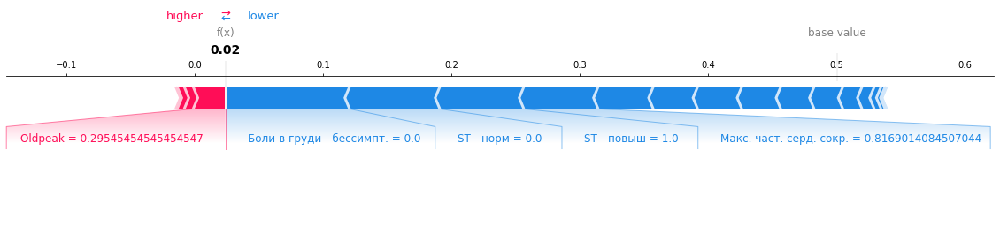

In [48]:
pid = 1
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

# shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1][pid], test_prep[examples_list[pid]],
                feature_names=features_names, matplotlib=True)

Правильный ответ на примере №157: 1
Предсказанный ответ на примере №157: 0
Уверенность в ответе на примере №157: 0.862


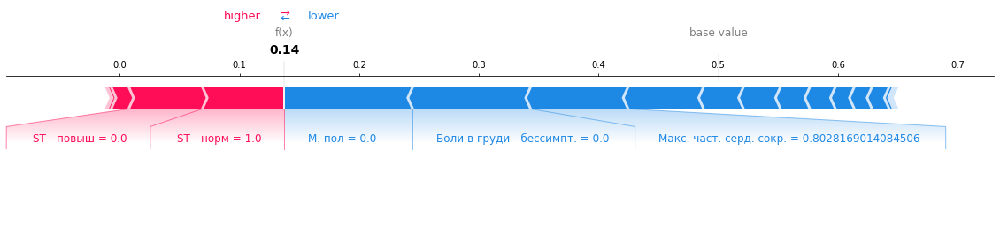

In [49]:
pid = 2
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

# shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1][pid], test_prep[examples_list[pid]],
                feature_names=features_names, matplotlib=True)

Правильный ответ на примере №213: 1
Предсказанный ответ на примере №213: 1
Уверенность в ответе на примере №213: 0.995


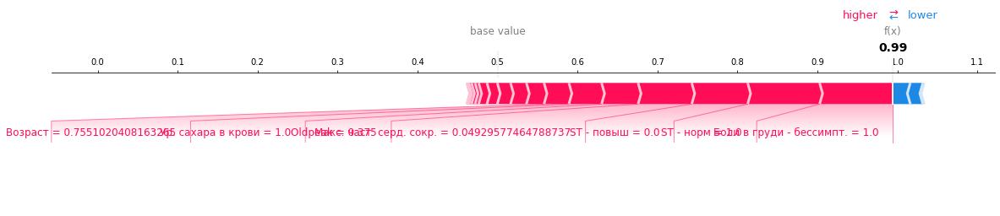

In [50]:
pid = 3
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

# shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1][pid], test_prep[examples_list[pid]],
                feature_names=features_names, matplotlib=True)

В целом довольно похожие объяснения на объяснения предыдущей модели, но есть некоторые отличия:
* Похожи в том, что важными признаками для принятия решения являются бессимпт. боли в груди и ST.
* Отличие в том, что RandomForest важным признаками для принятия решения являются Oldpeak и Макс. част. серд. сокр.

#### 3.3.3 Анализ выбранных примеров для модели ***MLPClassifier***
Пример -- (https://shap.readthedocs.io/en/latest/example_notebooks/tabular_examples/model_agnostic/Iris%20classification%20with%20scikit-learn.html)

In [51]:
model = nn_model.named_steps['classifier']
explainer = shap.KernelExplainer(model.predict_proba, train_prep)
shap_values = explainer.shap_values(test_prep[examples_list])

Using 641 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


  0%|          | 0/4 [00:00<?, ?it/s]

Правильный ответ на примере №237: 0
Предсказанный ответ на примере №237: 1
Уверенность в ответе на примере №237: 0.681


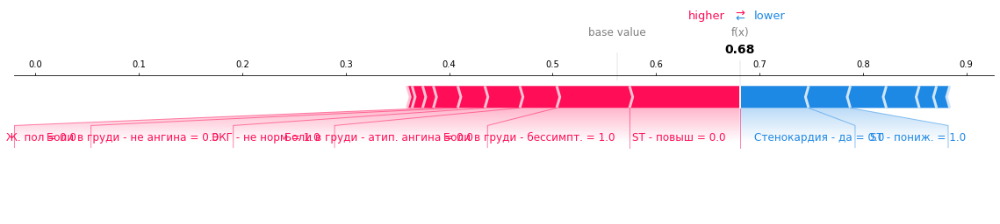

In [52]:
pid = 0
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

# shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1][pid], test_prep[examples_list[pid]],
                feature_names=features_names, matplotlib=True)

Правильный ответ на примере №91: 0
Предсказанный ответ на примере №91: 0
Уверенность в ответе на примере №91: 0.923


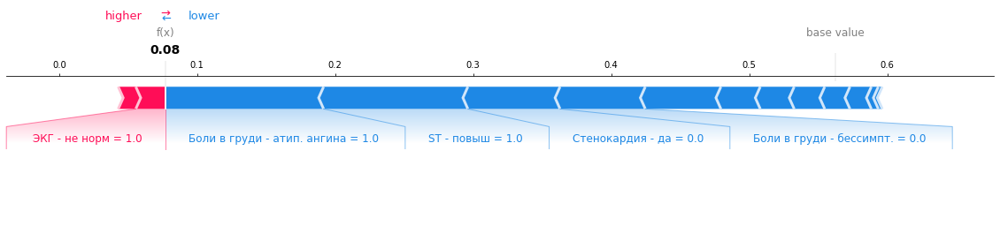

In [53]:
pid = 1
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

# shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1][pid], test_prep[examples_list[pid]],
                feature_names=features_names, matplotlib=True)

Правильный ответ на примере №157: 1
Предсказанный ответ на примере №157: 0
Уверенность в ответе на примере №157: 0.881


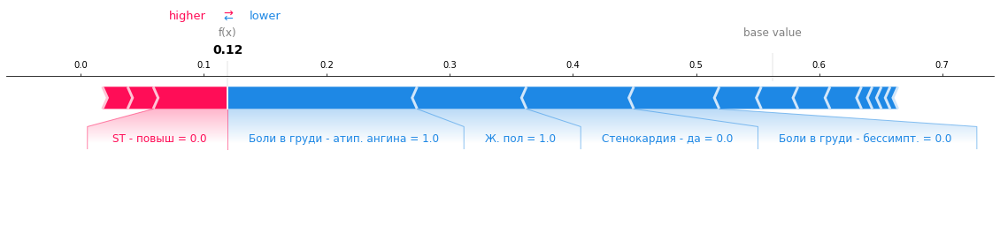

In [54]:
pid = 2
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

# shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1][pid], test_prep[examples_list[pid]],
                feature_names=features_names, matplotlib=True)

Правильный ответ на примере №213: 1
Предсказанный ответ на примере №213: 1
Уверенность в ответе на примере №213: 0.893


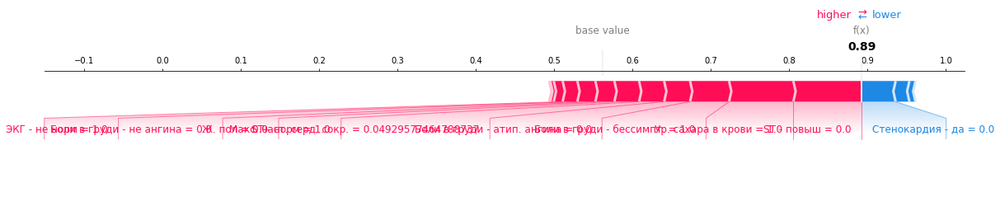

In [55]:
pid = 3
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

# shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1][pid], test_prep[examples_list[pid]],
                feature_names=features_names, matplotlib=True)

Объяснения также похожи на объяснения двух предыдущих моделей. Однако мы видим, что нейронные сети также сильно учитывают уровень сахара в крови.  

Отметим также, что все 3 модели одинаково ошиблись на ошибочных примерах и сделали правильное предсказание на наиболее уверенных и правильных.

### 🔹 **4** Применение LIME
Применить ***LIME*** к тем же моделям и тем же примерам, что и в предыдущем задании ( $4$ картинки $\cdot$ $3$ модели $= 12$ примеров). Получили ли вы похожее объяснения, что и в предыдущем примере? Если нет, можете ли вы это объяснить.

*Тонкий момент, который надо помнить: в ***LIME*** подаются оригинальные, т.е. данные, т.ч. к их категориальным признакам не применено OneHotEncoding, и указываются номера переменных, которые являются категориальными.*

#### 4.1 Подготовка lime.lime_tabular.LimeTabularExplainer

Смотрим на непредобработанный ***train***:

In [56]:
train.head()

,Age,Sex,ChestPainType,RestingBP,Cholesterol,FastingBS,RestingECG,MaxHR,ExerciseAngina,Oldpeak,ST_Slope
0,54,F,NAP,108,267,0,LVH,167,N,0.0,Up
1,55,M,ASY,120,226,0,LVH,127,Y,1.7,Down
2,62,F,ASY,160,164,0,LVH,145,N,6.2,Down
3,47,F,NAP,135,248,1,Normal,170,N,0.0,Flat
4,50,M,NAP,140,233,0,Normal,163,N,0.6,Flat


Получаем список имен признаков:

In [57]:
# feature_names = list(train.columns)
# feature_names

In [58]:
feature_names = [
    'Возраст',
    'Пол',
    'Тип боли в груди',
    'Арт. давл. покой',
    'Холестерин',
    'Ур. сахара в крови',
    'ЭКГ',
    'Макс. част. серд. сокр.',
    'Стенокардия',
    'Oldpeak',
    'ST_Slope',
]

***LIME*** на входе требует двумерные массивы:

In [59]:
dataset_train = train.values
dataset_test = test.values

Cписок имен категориальных признаков и их номера в исходном наборе данных: 

In [60]:
categorical_features = ['Sex', 'ChestPainType', 'RestingECG', 'ExerciseAngina', 'ST_Slope']
categorical_features_indices = [1, 2, 6, 8, 10]
print(categorical_features)
print(categorical_features_indices)

['Sex', 'ChestPainType', 'RestingECG', 'ExerciseAngina', 'ST_Slope']
[1, 2, 6, 8, 10]


***LIME*** требует, чтобы переменные были числовые, поэтому необходимо перекодировать все категориальные пременные, которые представлены в строковом формате. Заметим, что все модели тренировались не на таких данных -- придется совершить финт, который позволит обучать такие данные, а именно при обучении нужно будет совершать обратное преобразование.

In [61]:
label_encoders = []
categorical_names = {}
for i, feature in enumerate(categorical_features_indices):
    le = LabelEncoder()
    le.fit(dataset_train[:, feature])
    dataset_train[:, feature] = le.transform(dataset_train[:, feature])
    dataset_test[:, feature] = le.transform(dataset_test[:, feature])
    label_encoders.append(le)
    categorical_names[feature] = le.classes_
    

def predict_fn(x):
    """
    Необходимый финт, поскольку изначальные модели были обучены не
    на LabelEncoder, а LIME требует LabelEncoder.
    """
    xx = x.copy()
    xx = pd.DataFrame(xx, columns=list(train.columns))
    for i, feature in enumerate(categorical_features):
        le = label_encoders[i]
        xx[feature] = le.inverse_transform(xx[feature].astype(int))
    return model.predict_proba(prep_cat.transform(xx)).astype(float)

Создаем ***explainer*** для табличных данных. Важно подавать на вход не OHE категориальные признаки.

In [62]:
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=dataset_train,
    feature_names=feature_names,
    class_names=['Здоров ❤️', 'Приступ 💔'],
    categorical_features=categorical_features_indices, 
    categorical_names=categorical_names,
    random_state=123,
)

#### 4.2 LIME-анализ выбранных примеров для модели ***LogisticRegressionClassifier***

In [63]:
model = lr_model.named_steps['classifier']

In [64]:
pid = 0
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

exp = explainer.explain_instance(dataset_test[examples_list[pid]], predict_fn, num_features=6)
exp.show_in_notebook(show_all=False)

Правильный ответ на примере №237: 0
Предсказанный ответ на примере №237: 1
Уверенность в ответе на примере №237: 0.580


In [65]:
pid = 1
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

exp = explainer.explain_instance(dataset_test[examples_list[pid]], predict_fn, num_features=6)
exp.show_in_notebook(show_all=False)

Правильный ответ на примере №91: 0
Предсказанный ответ на примере №91: 0
Уверенность в ответе на примере №91: 0.675


In [66]:
pid = 2
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

exp = explainer.explain_instance(dataset_test[examples_list[pid]], predict_fn, num_features=6)
exp.show_in_notebook(show_all=False)

Правильный ответ на примере №157: 1
Предсказанный ответ на примере №157: 0
Уверенность в ответе на примере №157: 0.557


In [67]:
pid = 3
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

exp = explainer.explain_instance(dataset_test[examples_list[pid]], predict_fn, num_features=6)
exp.show_in_notebook(show_all=False)

Правильный ответ на примере №213: 1
Предсказанный ответ на примере №213: 1
Уверенность в ответе на примере №213: 0.668


#### 4.3 LIME-анализ выбранных примеров для модели ***RandomForestClassifier***

In [68]:
model = rf_model.named_steps['classifier']

In [69]:
pid = 0
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

exp = explainer.explain_instance(dataset_test[examples_list[pid]], predict_fn, num_features=6)
exp.show_in_notebook(show_all=False)

Правильный ответ на примере №237: 0
Предсказанный ответ на примере №237: 1
Уверенность в ответе на примере №237: 0.832


In [70]:
pid = 1
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

exp = explainer.explain_instance(dataset_test[examples_list[pid]], predict_fn, num_features=6)
exp.show_in_notebook(show_all=False)

Правильный ответ на примере №91: 0
Предсказанный ответ на примере №91: 0
Уверенность в ответе на примере №91: 0.976


In [71]:
pid = 2
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

exp = explainer.explain_instance(dataset_test[examples_list[pid]], predict_fn, num_features=6)
exp.show_in_notebook(show_all=False)

Правильный ответ на примере №157: 1
Предсказанный ответ на примере №157: 0
Уверенность в ответе на примере №157: 0.862


In [72]:
pid = 3
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

exp = explainer.explain_instance(dataset_test[examples_list[pid]], predict_fn, num_features=6)
exp.show_in_notebook(show_all=False)

Правильный ответ на примере №213: 1
Предсказанный ответ на примере №213: 1
Уверенность в ответе на примере №213: 0.995


#### 4.4 LIME-анализ выбранных примеров для модели ***MLPClassifier***

In [73]:
model = nn_model.named_steps['classifier']

In [74]:
pid = 0
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

exp = explainer.explain_instance(dataset_test[examples_list[pid]], predict_fn, num_features=6)
exp.show_in_notebook(show_all=False)

Правильный ответ на примере №237: 0
Предсказанный ответ на примере №237: 1
Уверенность в ответе на примере №237: 0.681


In [75]:
pid = 1
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

exp = explainer.explain_instance(dataset_test[examples_list[pid]], predict_fn, num_features=6)
exp.show_in_notebook(show_all=False)

Правильный ответ на примере №91: 0
Предсказанный ответ на примере №91: 0
Уверенность в ответе на примере №91: 0.923


In [76]:
pid = 2
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

exp = explainer.explain_instance(dataset_test[examples_list[pid]], predict_fn, num_features=6)
exp.show_in_notebook(show_all=False)

Правильный ответ на примере №157: 1
Предсказанный ответ на примере №157: 0
Уверенность в ответе на примере №157: 0.881


In [77]:
pid = 3
true_label = test_target.loc[examples_list[pid]].values
pred_label = model.predict(test_prep[[examples_list[pid]]])
confidence = model.predict_proba(test_prep[[examples_list[pid]]]).max()

print("Правильный ответ на примере №{}: {}".format(examples_list[pid], *true_label))
print("Предсказанный ответ на примере №{}: {}".format(examples_list[pid], *pred_label))
print("Уверенность в ответе на примере №{}: {:.3f}".format(examples_list[pid], confidence))

exp = explainer.explain_instance(dataset_test[examples_list[pid]], predict_fn, num_features=6)
exp.show_in_notebook(show_all=False)

Правильный ответ на примере №213: 1
Предсказанный ответ на примере №213: 1
Уверенность в ответе на примере №213: 0.893


#### 4.5 Вывод по LIME

Итак, ***LIME*** тоже позволил интерпретировать какие признаки влияют на тот или иной результат.  

Для ***LogisticRegressionClassifier***:
* Признаки, которые свидетельствуют за сердечный приступ 💔 -- Мужской пол, Бессимптомные боли в груди, ST_Slope=Flat, повышенный уровень сахара в крови.
* Признаки, которые свидетельствуют против сердечного приступа ❤️-- Отсутсвие стенкардии, низкий уровень сахара, ST_Slope=Up, Тип боли в груди=ATA. 

  
  
Для ***RandomForestClassifier***:
* Признаки, которые свидетельствуют за сердечный приступ 💔 -- Мужской пол, Бессимптомные боли в груди, Большой возраст, ST_Slope=Flat.
* Признаки, которые свидетельствуют против сердечного приступа ❤️-- Отсутсвие стенкардии, низкий уровень сахара, ST_Slope=Up,Тип боли в груди=ATA.



Для ***MLPClassifier***:
* Признаки, которые свидетельствуют за сердечный приступ 💔 -- Мужской пол, Бессимптомные боли в груди, повышенный уровень сахара в крови, ST_Slope=Flat.
* Признаки, которые свидетельствуют против сердечного приступа ❤️-- Отсутсвие стенкардии, низкий уровень сахара, ST_Slope=Up,Тип боли в груди=ATA.

Как видим, модели делали выводы примерно по одним и тем же признакам, однако все-таки каждая модель ориентировалась по-своему.

Если сравнивать полученные результаты с ***SHAP***, то можно заметить, что важность признаков и их интерпретации очень схода с ***LIME***. Однако не стоит забывать, что ***SHAP*** лучше объясняется чем ***LIME***, поэтому предпочтительнее ориентироваться на его выводы. 